In [1]:
%load_ext jupyternotify

# DATA_DIR = "/content/drive/My Drive/Colab Notebooks/Generative models/"
DATA_DIR = "/home/v-eliseev/Datasets/cats/"

<IPython.core.display.Javascript object>

In [49]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
from matplotlib.pyplot import figure

import cv2

import math

import torch
import torch.nn as nn
import torch.nn.functional as F


from IPython.display import clear_output

import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import torchvision.utils as vutils


import matplotlib.animation as animation
from IPython.display import HTML

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

from PIL import Image



# plt.ion()   # interactive mode

In [3]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**10

In [4]:
from tqdm.notebook import trange, tqdm

In [5]:
# %%capture output


In [6]:
# output.show()

## Dataset prepare

## Dataset

In [81]:
DATA_DIR = "/home/v-eliseev/Datasets/cats/"

class CatsDataset(Dataset):
    def __init__(self, names_file, img_dir, transform=None):
        self.names = pd.read_csv(names_file).head(4)
        self.img_dir = img_dir
        self.transform = transform

    def __len__(self):
        return len(self.names)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        img_name = os.path.join(self.img_dir,
                                self.names.iloc[idx, 0])
#         image = io.imread(img_name)
        image = Image.open(img_name)

        if self.transform:
            image = self.transform(image)

        return image

In [82]:
class Preprocess(object):
    """Convert ndarrays in sample to Tensors."""

    def __call__(self, sample):
        # resize
        image = cv2.resize(sample, dsize=(64, 64), interpolation=cv2.INTER_CUBIC)
        # map to [-1; 1]
        image = (image.astype(np.float)*2-255)/255
        # swap color axis because
        # numpy image: H x W x C
        # torch image: C X H X W
        image = image.transpose((2, 0, 1))
        return torch.from_numpy(image).float()

In [83]:
def imshow(img, ax, name=None):
    img = np.transpose(img.numpy(), (1, 2, 0))
    ax.imshow(img)
    ax.axis('off')
    if name != None:
        plt.savefig(name + ".png")
    else:
        plt.show()

In [84]:
cats_dataset = CatsDataset(names_file=DATA_DIR+"faces_index.txt", img_dir=DATA_DIR+"faces/", transform=transforms.Compose([
                                        transforms.RandomAffine(
                                            degrees=120
                                        ),
                                        transforms.ToTensor()]))
dataloader = DataLoader(cats_dataset, batch_size=16,
                        shuffle=True, num_workers=0)

In [85]:
def noisy(image, device='cpu:0'):
    b = -0.15
    a = 0.15
    mean = np.random.random_sample()*(b - a) + a
    var = 0.03
    sigma = var**0.5
    gauss = torch.randn(image.size(), device=device)*sigma  + mean
    noisy = image + gauss
    return torch.clamp(noisy, -1.0, 1.0)


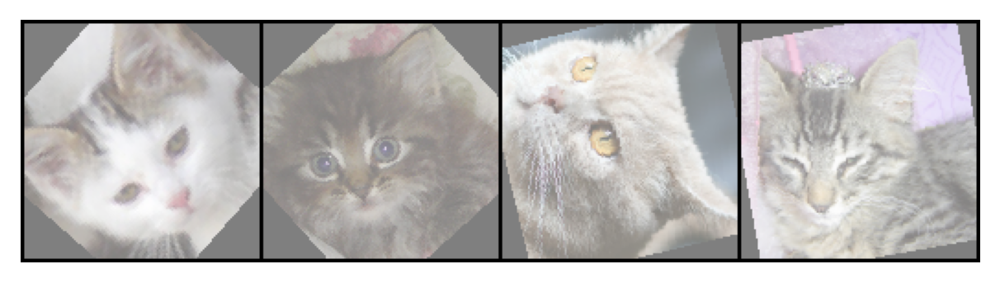

In [95]:
import torchvision

for i_batch, im in enumerate(dataloader):
#     print(i_batch, sample_batched.size())

    if i_batch == 0:
        fig, ax = plt.subplots()
        fig.dpi = 250
#         im = noisy(im)
        im = (im+1.0)/2.0
        
        imshow(torchvision.utils.make_grid(im, nrow=4), ax)
        break

In [72]:
data_it = iter(dataloader)

im1 = next(data_it)
im2 = noisy(im1)

im1 = ((im1+1.0)/2.0)
im2 = ((im2+1.0)/2.0)

im1_l = [im1[i].view(3, 64, 64) for i in range(16)]
im2_l = [im2[i].view(3, 64, 64) for i in range(16)]

# plt.subplots_adjust(wspace=0.05, hspace=0.1)
fig, axs = plt.subplots(math.ceil(len(im1_l)/4), 4)
fig.set_dpi(96)
fig.set_size_inches(4*5, math.ceil(len(im1_l)/4)*5/2)

scores = torch.rand(16)
for (img1, img2, sc, ax) in zip(im1_l, im2_l, scores, axs.flatten()):
    img1 = img1.permute(1, 2, 0).numpy()
    img2 = img2.permute(1, 2, 0).numpy()
    img = horizontal = np.concatenate((img1, img2), axis = 1)

    ax.imshow(img)
    ax.axis('off')
    ax.set_title("{:.2f}".format(sc.item()))
    
fig.show()
fig.savefig('1.png')


RuntimeError: shape '[3, 64, 64]' is invalid for input of size 49152

In [45]:
loss = nn.BCEWithLogitsLoss()
a = torch.Tensor([0.2, 0.3, 0.55, 0.69])
b = torch.Tensor([0.2, 0.3, 0.95, 0.69])

print(loss(a,b).mean())

tensor(0.6565)


In [15]:
a = torch.rand(3, 4)
b = torch.zeros(1, 4)

idx = 1
c = torch.cat([a[:idx], b, a[idx:]], 0)
c

tensor([[0.6463, 0.7486, 0.8362, 0.3330],
        [0.0000, 0.0000, 0.0000, 0.0000],
        [0.2223, 0.8062, 0.6139, 0.8358],
        [0.6707, 0.3394, 0.6123, 0.9296]])

## Models


In [13]:
# TEST
# f = torch.randn(64, LATENT, 1, 1)
# c1 = nn.ConvTranspose2d(LATENT, 512, (4, 4), 1, 0, bias=False) # ->4x4
# c1(f).shape

# l1 = nn.Linear(in_features=LATENT, out_features=2048)
# c1.weight.shape

In [14]:
BATCH_SIZE = 64
LATENT   = 100
LATENT_2 = 100 # 16x16+

dataloader = DataLoader(cats_dataset, batch_size=BATCH_SIZE,
                        shuffle=True, num_workers=0)

In [15]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [16]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.l1 = nn.Linear(in_features=LATENT, out_features=LATENT*2)
        self.lb1 = nn.BatchNorm1d(LATENT*2)
        self.l2 = nn.Linear(in_features=LATENT*2, out_features=LATENT*3)
        self.lb2 = nn.BatchNorm1d(LATENT*3)
        self.l3 = nn.Linear(in_features=LATENT*3, out_features=LATENT)
        self.lb3 = nn.BatchNorm1d(LATENT)

        self.c1 = nn.ConvTranspose2d(LATENT, 512, (4, 4), 1, 0, bias=True) # -> 4x4
        self.b1 = nn.BatchNorm2d(512)

        self.c2 = nn.ConvTranspose2d(512,    128, (4, 4), 2, 1, bias=True) # -> 8x8
        self.b2 = nn.BatchNorm2d(128)

        self.c3 = nn.ConvTranspose2d(128,    64, (4, 4), 2, 1, bias=True) # -> 16x16
        self.b3 = nn.BatchNorm2d(64)
        
#         self.cc1 = nn.Conv2d(512, 256, (3, 3), 1, 1, bias=True) # -> 16x16
#         self.ccb1 = nn.BatchNorm2d(256)
        
        self.c4 = nn.ConvTranspose2d(64,     3, (4, 4), 2, 1, bias=True) # -> 32x32
        self.b4 = nn.BatchNorm2d(3)
        
#         self.cc2 = nn.Conv2d(256, 3, (3, 3), 1, 1, bias=True) # -> 32x32
#         self.ccb2 = nn.BatchNorm2d(128)

        
#         self.c5 = nn.ConvTranspose2d(64,      3, (4, 4), 2, 1, bias=True) # -> 64x64
#         self.b5 = nn.BatchNorm2d(64)
        
#         self.cc3 = nn.Conv2d(64, 3, (3, 3), 1, 1, bias=True) # -> 64x64

        self.drop = nn.Dropout(p=0.01)

    def forward(self, z1):
        x = self.l1(z1)
        x = self.lb1(x)
        x = F.leaky_relu(x)
        
        x = self.l2(x)
        x = self.lb2(x)
        x = F.leaky_relu(x)
        
        x = self.l3(x)
        x = self.lb3(x)
        x = F.leaky_relu(x)
        
        x = x.view(-1, LATENT, 1, 1)
    
        x = self.c1(x)
        x = self.b1(x)
        x = F.leaky_relu(x)

        x = self.c2(x)
        x = self.b2(x)
        x = F.leaky_relu(x)

        x = self.c3(x)
        x = self.b3(x)
        x = F.leaky_relu(x)
        
#         x = self.cc1(x)
#         x = self.ccb1(x)
#         x = F.leaky_relu(x)

        x = self.c4(x)
#         x = self.b4(x)
#         x = F.leaky_relu(x)
                
#         x = self.cc2(x)
#         x = self.ccb2(x)
#         x = F.leaky_relu(x)

#         x = self.c5(x)
#         x = self.b5(x)
#         x = F.leaky_relu(x)
        
#         x = self.cc3(x)
        x = torch.tanh(x)
        
        return x

gen = Generator().cuda()
gen.apply(weights_init)

Generator(
  (l1): Linear(in_features=100, out_features=200, bias=True)
  (lb1): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (l2): Linear(in_features=200, out_features=300, bias=True)
  (lb2): BatchNorm1d(300, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (l3): Linear(in_features=300, out_features=100, bias=True)
  (lb3): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (c1): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1))
  (b1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (c2): ConvTranspose2d(512, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (b2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (c3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (b3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (c4): ConvTranspose2d(64, 3, k

In [17]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
#         self.c1 = nn.Conv2d(3, 64, 4, 2, padding=1)  # ->32x32
#         self.b1 = nn.BatchNorm2d(64)
        
#         self.c2 = nn.Conv2d(64, 64, 3, 1, padding=1)  # ->32x32
#         self.b2 = nn.BatchNorm2d(64)

        self.c3 = nn.Conv2d(3, 128, 4, 2, padding=1)  # ->16x16
        self.b3 = nn.BatchNorm2d(128)
        
        self.c4 = nn.Conv2d(128, 256, 4, 2, padding=1)  # ->8x8
        self.b4 = nn.BatchNorm2d(256)
        
        self.c5 = nn.Conv2d(256, 512, 4, 2, padding=1)  # ->4x4
        self.b5 = nn.BatchNorm2d(512)
        

#         self.c5 = nn.Conv2d(512, 512, 3, 2, padding=1)  # ->8x8
#         self.b5 = nn.BatchNorm2d(64)
        
#         self.c6 = nn.Conv2d(512, 1024, 3, 2, padding=1)  # ->4x4
#         self.b6 = nn.BatchNorm2d(32)
        
#         self.c5 = nn.Conv2d(512, 512, 3, 1, padding=1)   # ->8x8

        self.l1 = nn.Linear(in_features=512*4*4, out_features=1)
#         self.l2 = nn.Linear(in_features=8*4*4, out_features=1)

        
        self.drop = nn.Dropout(p=0.3)
        
    def forward(self, x):
#         x = self.c1(z1)
#         x = self.b1(x)
#         x = F.leaky_relu(x)

#         x = self.c2(x)
#         x = self.b2(x)
#         x = F.leaky_relu(x)

        x = self.c3(x)
        x = self.b3(x)
        x = F.leaky_relu(x)
        
        x = self.c4(x)
        x = self.b4(x)
        x = F.leaky_relu(x)
        
        x = self.c5(x)
        x = self.b5(x)
        x = F.leaky_relu(x)
        
#         x = self.c6(x)
#         x = self.b6(x)
#         x = F.leaky_relu(x)
        
        x = x.view(-1, 512*4*4)
        x = self.l1(x)

        return x
    
dis = Discriminator().cuda()
dis.apply(weights_init)

Discriminator(
  (c3): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (b3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (c4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (b4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (c5): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (b5): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (l1): Linear(in_features=8192, out_features=1, bias=True)
  (drop): Dropout(p=0.3, inplace=False)
)

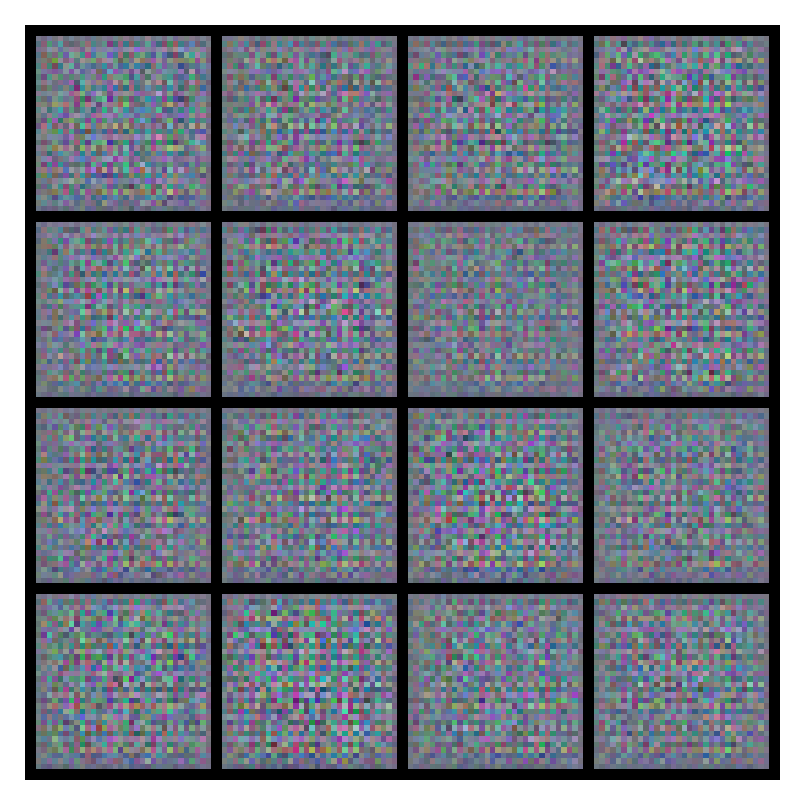

tensor([[ 0.0252],
        [-0.4308],
        [-0.0750],
        [-0.1124],
        [ 0.0177],
        [-0.6652],
        [-0.3208],
        [-0.5253],
        [-0.1141],
        [-0.8772],
        [ 0.1115],
        [-0.2751],
        [-0.5681],
        [ 0.2466],
        [-0.5505],
        [ 0.0025]], device='cuda:0')


In [18]:
data = gen(torch.randn(16, LATENT).cuda()).cpu()
fig, ax = plt.subplots()
fig.dpi = 250
imshow(torchvision.utils.make_grid((data.detach()+1)/2, nrow=4), ax)
print(dis(data.cuda()).detach())
plt.close()

In [19]:
device = 'cuda'

gen = Generator().to(device)
dis = Discriminator().to(device)
gen.apply(weights_init)
dis.apply(weights_init)

fixed_noise  = torch.randn(36, LATENT, device=device)

real_label = 0.9
fake_label = 0.0

img_list = []
G_losses = []
D_losses = []
iters = 0

In [20]:
def sigmoid(x):
      return 1 / (1 + math.exp(-x))

In [21]:
import torch.optim as optim

op_gen = optim.Adam(gen.parameters(), lr=0.00007, betas=(0.5, 0.999))
op_dis = optim.Adam(dis.parameters(), lr=0.0001, betas=(0.5, 0.999)) 
# criterion = nn.BCELoss()
criterion = nn.BCEWithLogitsLoss()
# criterion = nn.MSELoss()

In [22]:
%%notify
dataiter = iter(dataloader)
stepsD = 1
stepsG = 1
steper = 0
num_epochs = 100

g_loss = criterion(torch.zeros(1), torch.zeros(1))
d_loss = criterion(torch.zeros(1), torch.zeros(1))

pbar = tqdm()
pbar.reset(total=num_epochs*len(dataloader))  # initialise with new `total`

for epoch in range(num_epochs):
    if epoch == 25:
        op_gen = optim.Adam(gen.parameters(), lr=0.000007, betas=(0.5, 0.999))
        op_dis = optim.Adam(dis.parameters(), lr=0.00001, betas=(0.5, 0.999))
    if epoch == 50:
        op_gen = optim.Adam(gen.parameters(), lr=0.0000028, betas=(0.5, 0.999))
        op_dis = optim.Adam(dis.parameters(), lr=0.000004, betas=(0.5, 0.999))

    for i, data in enumerate(dataloader, 0):
        data_device = data.to(device)
        if steper == stepsD + stepsG - 1:
            steper = 0
            
        if steper < stepsD:
            # Discriminator
            op_dis.zero_grad()
            # True

#             imgs = noisy(data_device, device=device)
            imgs = data_device

            output_real = dis(imgs).view(-1)

            label_real = torch.full((output_real.size()[0],), real_label, device=device) 
            D_x = output_real.mean().item()

            # False
            z = torch.randn(imgs.size()[0], LATENT, device=device)
            imgs = gen(z)
#             imgs = noisy(imgs, device=device)

            output_fake = dis(imgs).view(-1)
            label_fake = torch.full((output_fake.size()[0],), fake_label, device=device)


            real_loss = criterion(output_real-output_fake, label_real)
            fake_loss = criterion(output_fake-output_real, label_fake)

            d_loss = (real_loss + fake_loss) / 2

            d_loss.backward()

            D_G_z1 = output_fake.mean().item()

            op_dis.step()
                            
        if steper >= stepsD - 1:
            # Generator
            op_gen.zero_grad()

#             imgs = noisy(data_device, device=device)
            imgs = data_device

            output_real = dis(imgs).view(-1)

            z = torch.randn(imgs.size()[0], LATENT, device=device)
            output_fake = dis(gen(z)).view(-1)

            label_g = torch.full((output_fake.size()[0],), real_label, device=device) 
            g_loss = criterion(output_fake-output_real, label_g)
            g_loss.backward()

            op_gen.step()
            D_G_z2 = output_fake.mean().item()
                            
        if i == len(dataloader) - 1:
            print('[{:3d}/{:d}][{:3d}/{:d}]  Loss_D: {:.4f}  Loss_G: {:.4f} | D(x): {:.4f}  D(G(z)): {:.4f} / {:.4f}'.format(
                epoch, num_epochs-1, i, len(dataloader)-1,
                d_loss.item(), g_loss.item(), sigmoid(D_x), sigmoid(D_G_z1), sigmoid(D_G_z2)))

                            
        if iters % 100 == 0:
            G_losses.append(g_loss.item())
            D_losses.append(d_loss.item())
            
        if i == len(dataloader) - 1:
            with torch.no_grad():
                fake = gen(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True, nrow=6))

        iters += 1
        steper += 1
        pbar.update()

[  0/99][156/156]  Loss_D: 0.2116  Loss_G: 2.5463 | D(x): 0.9738  D(G(z)): 0.6899 / 0.6940
[  1/99][156/156]  Loss_D: 0.2176  Loss_G: 3.1946 | D(x): 0.9853  D(G(z)): 0.5891 / 0.6268
[  2/99][156/156]  Loss_D: 0.2286  Loss_G: 4.6086 | D(x): 0.8841  D(G(z)): 0.4316 / 0.0851
[  3/99][156/156]  Loss_D: 0.2083  Loss_G: 2.9529 | D(x): 0.9347  D(G(z)): 0.4290 / 0.4260
[  4/99][156/156]  Loss_D: 0.2124  Loss_G: 3.5837 | D(x): 0.8208  D(G(z)): 0.1547 / 0.1034
[  5/99][156/156]  Loss_D: 0.2091  Loss_G: 2.3002 | D(x): 0.9249  D(G(z)): 0.2599 / 0.2332
[  6/99][156/156]  Loss_D: 0.2188  Loss_G: 3.2008 | D(x): 0.7986  D(G(z)): 0.1414 / 0.1139
[  7/99][156/156]  Loss_D: 0.2288  Loss_G: 2.8901 | D(x): 0.8398  D(G(z)): 0.1862 / 0.2511
[  8/99][156/156]  Loss_D: 0.2408  Loss_G: 4.5103 | D(x): 0.5209  D(G(z)): 0.0799 / 0.0117
[  9/99][156/156]  Loss_D: 0.2171  Loss_G: 3.7726 | D(x): 0.4379  D(G(z)): 0.0563 / 0.0195
[ 10/99][156/156]  Loss_D: 0.2425  Loss_G: 3.4427 | D(x): 0.2797  D(G(z)): 0.0264 / 0.0231

<IPython.core.display.Javascript object>

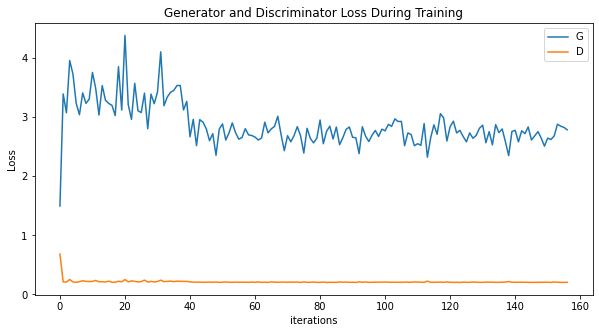

In [23]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

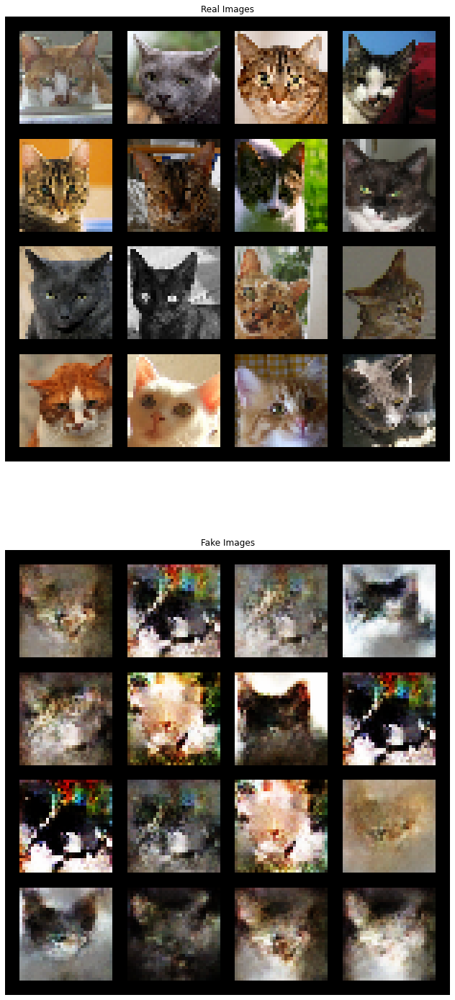

In [24]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(25,25))
plt.subplot(2,1,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to('cuda:0')[:16], padding=5, normalize=True, nrow=4).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(2,1,2)
plt.axis("off")
plt.title("Fake Images")
noise = torch.randn(16, LATENT).cuda()
plt.imshow(np.transpose(vutils.make_grid(gen(noise).detach(), padding=5, normalize=True, nrow=4).cpu(),(1,2,0)))
plt.show()

In [25]:
def image_with_title(img, title_text, info_text):
    plt.axis('off');
#     title = plt.text(0,-7,
#                     title_text, 
#                     fontsize=26)
#     title.set_bbox(dict(facecolor='white', alpha=1.0, edgecolor='white'))
#     info = plt.text(0,32*6+22,
#                     info_text, 
#                     fontsize=14)
#     info.set_bbox(dict(facecolor='white', alpha=1.0, edgecolor='white'))
    img_n = plt.imshow(np.transpose(img,(1,2,0)), animated=True);
    return [img_n]

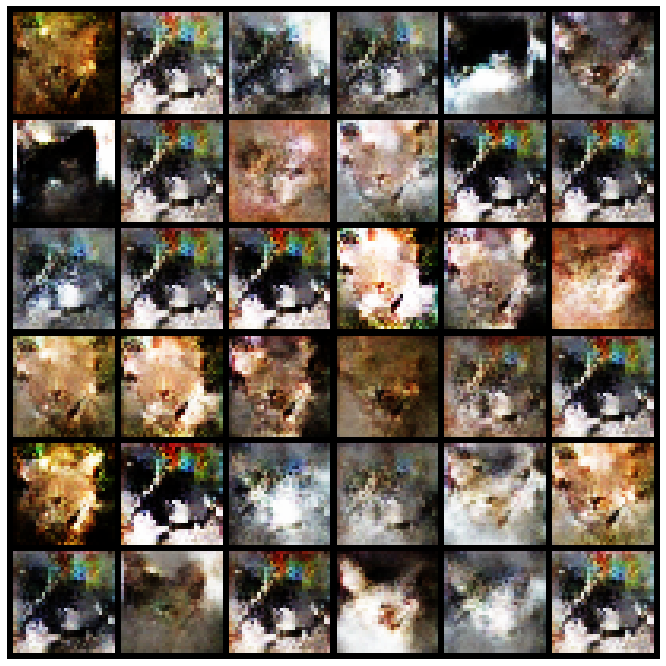

In [26]:
#%%capture
fig = plt.figure(figsize=(12,12));
ims = [
    image_with_title(img,
                     "Epoch: {}".format(i),
                     "[RGAN] Batch size: {0}, Latent space: {1}, size {2}x{2}".format(BATCH_SIZE, LATENT, 32))
    for i, img in enumerate(img_list)
    ];
ani = animation.ArtistAnimation(fig, ims, interval=200, repeat_delay=1000, blit=True);

HTML(ani.to_jshtml())

In [27]:
ani.save("cats3.gif")

In [ ]:
g_w = gen.state_dict()
d_w = dis.state_dict()
torch.save(g_w, 'c_gen.pth')
torch.save(d_w, 'c_dis.pth')

In [ ]:
g_w = torch.load('c_gen.pth')
d_w = torch.load('c_dis.pth')
gen.load_state_dict(g_w)
dis.load_state_dict(d_w)

In [ ]:
g_w = torch.load('gen_save.pth')
d_w = torch.load('dis_save.pth')
gen.load_state_dict(g_w)
dis.load_state_dict(d_w)